In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import imageio
from IPython.display import Image

##Monodomínio com modelo FHN 

Cable equation

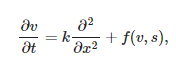

FHN Model

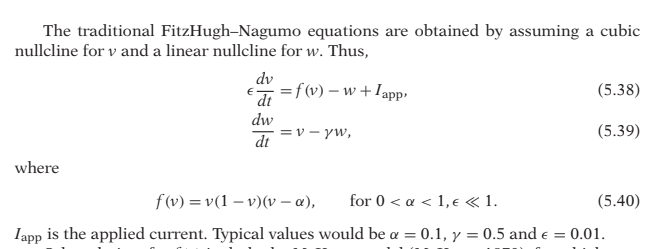

Cable Eq with FHN Model

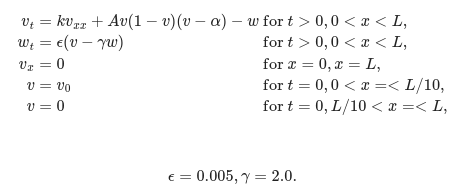

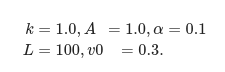

###Solução do GitHub (https://github.com/joventino/SSCP_2019_master/tree/master/L08%20(Electrical%20Conduction%20in%20the%20Heart)

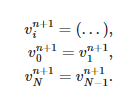

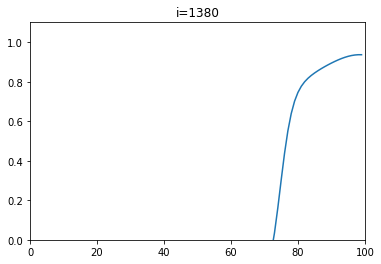

In [ ]:
k = 2.0
A = 1.0
alpha = 0.1
L =100
eps = 0.005
gamma = 2.0

dx = 1
dt = 0.1

N = int(L/dx)

v = np.zeros(N)
w = np.zeros(N)
left =  int(N/10)
v[:left] = 0.3

I = np.arange(1,N-1)
Ip = I+1
Im = I-1

for i in range (1400):
    I_ion = A*v*(1-v)*(v-alpha) -w
    v[I] = v[I] + dt*(k/dx**2)*(v[Ip]-2*v[I] +v[Im])
    v = v + dt*I_ion;    
    w = w +dt*eps*(v-gamma*w)
        
    v[0] = v[1]
    v[N-1] = v[N-2]
    if i%20==0:  #to avoid displaying every time step
        plt.clf()
        plt.axis([0, L, 0, 1.1])
        plt.plot(v)
        plt.title('i=%d' % i)

###Mudanças

In [ ]:
def plot_gif(V, n=20):
  filenames = []

  for i in range(len(V)):
    aux = np.zeros((len(V[0]), len(V[0])))
    
    for j in range(len(V[0])):
      aux[j,:] = V[i,:]
    
    if i%n==0:
      fig, (ax1, ax2) = plt.subplots(2, figsize=(8,8))
      ax1.plot(V[i,:])
      ax1.set_xlim(0, 150)
      ax1.set_ylim(-0.4, 1.3)
      ax1.set_xlabel('L')
      ax1.set_ylabel('v')

      plt.imshow(aux, cmap='plasma')
      plt.xlabel('L')
      plt.ylabel('L')
      plt.imshow(aux, cmap='plasma', vmin=-0.4, vmax=1.2)
      plt.colorbar(label='v')

      filename = f'{i}.png'
      filenames.append(filename)
        
      plt.savefig(filename)
      plt.close()

  with imageio.get_writer('c_eq.gif', mode='I') as writer:
    for filename in filenames:
      image = imageio.imread(filename)
      writer.append_data(image)

array([[ 0.3       ,  0.3       ,  0.3       , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.3042    ,  0.3042    ,  0.3042    , ...,  0.        ,
         0.        ,  0.        ],
       [ 0.30850694,  0.30850694,  0.30850694, ...,  0.        ,
         0.        ,  0.        ],
       ...,
       [-0.00430987, -0.00430987, -0.00433429, ...,  0.87134297,
         0.87299517,  0.87299517],
       [-0.00426868, -0.00426868, -0.00429298, ...,  0.87061142,
         0.87226847,  0.87226847],
       [-0.0042277 , -0.0042277 , -0.00425189, ...,  0.86987792,
         0.87153991,  0.87153991]])

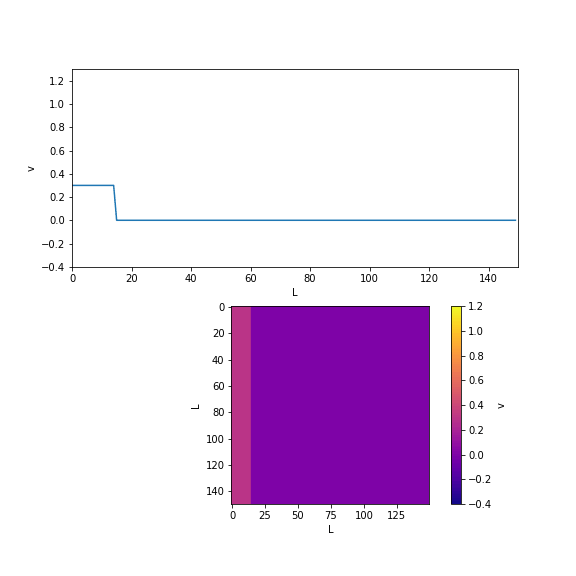

In [ ]:
k = 2.0
A = 1.0
alpha = 0.1
L = 150
eps = 0.005
gamma = 2.0

delta_x = 1
delta_t = 0.1

T = 210
t = np.arange(0.0, T+delta_t, delta_t)

M = int(T/delta_t) # num of points in time
N = int(L/delta_x) # num of points in space

V = np.zeros((M, N))
W = np.zeros((M, N))

# initial condition
V[0,0:int(N/10)] = 0.3

# euler explicito
for j in range(M-1):
  for i in range(1, N-1): 
    V[j+1,i] = V[j,i] + (k*delta_t/delta_x**2)*(V[j,i+1]-2*V[j,i]+V[j,i-1]) + delta_t*(A*V[j,i]*(1-V[j,i])*(V[j,i]-alpha) - W[j,i])
    W[j+1,i] = W[j,i] + delta_t*eps*(V[j+1,i]-gamma*W[j,i])

  # condição determinada
  V[j+1,0] = V[j+1,1]
  V[j+1,N-1] = V[j+1,N-2]

display(V)
plot_gif(V)
Image(filename='c_eq.gif')

##Parte 2 - reentry

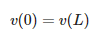

###Solução Git

In [ ]:
k = 2.0
A = 1.0
alpha = 0.1
L =100
eps = 0.005
gamma = 2.0

dx = 1;
dt = 0.1;

N = int(L/dx)

v = np.zeros(N);
w = np.zeros(N)
mid =  int(N/2);
v[mid-10:mid+10] = 0.3;
w[:int(0.9*mid)] = 0.1

I = np.arange(N)
Ip = I+1
Ip[N-1] = 0
Im = I-1;
Im[0] = N-1

for i in range (1400):
    I_ion = A*v*(1-v)*(v-alpha) -w
    v[I] = v[I] + dt*(k/dx**2)*(v[Ip]-2*v[I] +v[Im])
    v = v + dt*I_ion;    
    w = w +dt*eps*(v-gamma*w)
        
    # #v[0] = v[N-1]
    # #v[N-1] = v[N-2]
    # if i%20==0:  #to avoid displaying every time step
    #     #plt.clf()
    #     plt.axis([0, L, -0.4, 1.1])
    #     plt.plot(v)
    #     plt.plot(w)
    #     plt.title('i=%d' % i)
    #     plt.show()
v

array([-0.19770332, -0.20191698, -0.20478842, -0.20734678, -0.20998987,
       -0.21281251, -0.21574885, -0.21861765, -0.22111063, -0.22273513,
       -0.22270482, -0.21975897, -0.21188501, -0.19593512, -0.16720931,
       -0.11931257, -0.04505511,  0.06044542,  0.19437219,  0.34249627,
        0.48371482,  0.6012759 ,  0.68951967,  0.75167429,  0.79439889,
        0.82407548,  0.8454834 ,  0.86177666,  0.87487403,  0.88585697,
        0.89525752,  0.90322903,  0.90961996,  0.91396766,  0.91541843,
        0.91257202,  0.9032536 ,  0.88425309,  0.85118094,  0.79880869,
        0.72252039,  0.62130239,  0.50118658,  0.37580648,  0.26159373,
        0.17120603,  0.09906759,  0.04553566,  0.00762711, -0.01854837,
       -0.03650081, -0.0489328 , -0.05775014, -0.06422547, -0.06917804,
       -0.07312153, -0.07637302, -0.07912944, -0.08152043, -0.0836446 ,
       -0.0855955 , -0.08746659, -0.08932137, -0.09119559, -0.09310906,
       -0.09507244, -0.09709121, -0.09916782, -0.10130303, -0.10

###Mudanças

array([[ 0.        ,  0.        ,  0.        , ...,  0.        ,
         0.        ,  0.        ],
       [-0.01      , -0.01      , -0.01      , ...,  0.        ,
         0.        ,  0.        ],
       [-0.0178784 , -0.0198784 , -0.0198784 , ...,  0.        ,
         0.        , -0.002     ],
       ...,
       [ 0.91500207,  0.90489604,  0.88548884, ...,  0.9152803 ,
         0.918721  ,  0.91923055],
       [ 0.91545918,  0.90590521,  0.88730415, ...,  0.91495617,
         0.91856163,  0.91931729],
       [ 0.91588416,  0.90686671,  0.88905081, ...,  0.9146224 ,
         0.91838802,  0.91938264]])

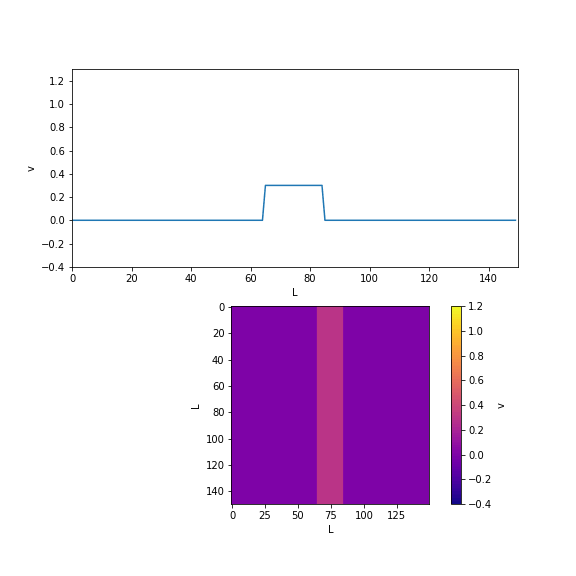

In [ ]:
k = 2.0
A = 1.0
alpha = 0.1
L = 150
eps = 0.005
gamma = 2.0

delta_x = 1
delta_t = 0.1

T = 320
t = np.arange(0.0, T+delta_t, delta_t)

M = int(T/delta_t) # num of points in time
N = int(L/delta_x) # num of points in space

V = np.zeros((M, N))
W = np.zeros((M, N))

# initial condition
middle = int(N/2)
V[0, middle-10 : middle+10] = 0.3
W[0, 0 : int(0.9*middle)] = 0.1

# euler explicito
for j in range(M-1):
  for i in range(N):
    if i-1<0:
      V[j+1,i] = V[j,i] + (k*delta_t/delta_x**2)*(V[j,i+1]-2*V[j,i]+V[j,N-1]) + delta_t*(A*V[j,i]*(1-V[j,i])*(V[j,i]-alpha) - W[j,i])
    elif i+1==N:
      V[j+1,i] = V[j,i] + (k*delta_t/delta_x**2)*(V[j,0]-2*V[j,i]+V[j,i-1]) + delta_t*(A*V[j,i]*(1-V[j,i])*(V[j,i]-alpha) - W[j,i])
    else:
      V[j+1,i] = V[j,i] + (k*delta_t/delta_x**2)*(V[j,i+1]-2*V[j,i]+V[j,i-1]) + delta_t*(A*V[j,i]*(1-V[j,i])*(V[j,i]-alpha) - W[j,i])
    
    W[j+1,i] = W[j,i] + delta_t*eps*(V[j+1,i]-gamma*W[j,i])

display(V)
plot_gif(V)
Image(filename='c_eq.gif')